# Watch Movement Classification
<hr>

Date : 22/02/2023  
Auteur : Gaël Penessot  
email : gaelpenessot@data-decision.io  
  
This notebook is a POC for watch movement classification based on CNN (VGG & ResNet).

## 1. Load and preprocess images

### 1.1 Setup

In [1]:
import os
import io
from datetime import datetime

import PIL
import PIL.Image
from IPython.display import Image
import matplotlib.pyplot as plt
import matplotlib.cm as cm

import sklearn.metrics
import numpy as np
import itertools

import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator

from tensorflow.keras.applications.resnet_v2 import ResNet50V2
from tensorflow.keras.applications.resnet_v2 import preprocess_input as preprocess_resnetv2

from tensorflow.keras.applications.vgg16 import VGG16 
from tensorflow.keras.applications.vgg16 import preprocess_input as preprocess_vgg16

from tensorflow.keras.applications.vgg19 import VGG19
from tensorflow.keras.applications.vgg19 import preprocess_input as preprocess_vgg19

from tensorflow.keras.applications.resnet import ResNet152

from tensorflow.keras.layers import GlobalAveragePooling2D, Dense, Dropout, Flatten, Conv2D, MaxPooling2D
from tensorflow.keras import Sequential, Model, losses, Input, layers
from tensorflow.keras.models import load_model

from tensorflow.keras.callbacks import LearningRateScheduler, ReduceLROnPlateau, EarlyStopping, ModelCheckpoint, TensorBoard, LambdaCallback
from tensorflow.keras.optimizers import Adam, RMSprop, Adadelta
from tensorflow.keras.losses import SparseCategoricalCrossentropy, CategoricalCrossentropy
from tensorflow.keras.utils import load_img, img_to_array

import pprint
import h5py

In [2]:
# Check TF version
print(tf.__version__)

2.10.0


In [3]:
# Check if GPU is available on current machine
tf.config.list_physical_devices('GPU')

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [4]:
# Directory to dataset
DATA_DIR = r'C:/Users/gaelp/Documents/watch_app/movement_database/'

### 1.2 Load data

Let's load these images off disk using the helpful `tf.keras.utils.image_dataset_from_directory` utility.

### Create a dataset

Define some parameters for the loader:

In [5]:
BATCH_SIZE = 8 # Reduced to 4 to fit GPU memory
IMG_HEIGHT = 256
IMG_WIDTH = 256
IMG_SHAPE = (256, 256)

In [6]:
# Validation ImageDataGenerator with rescaling.
valid_datagen = ImageDataGenerator(rescale=1./255, 
                                   validation_split=0.2)

# Training ImagaDataGenerator with Augmentation transf.  
train_datagen = ImageDataGenerator(rescale=1./255, 
                                   validation_split=0.2,
                                   horizontal_flip=False,
                                   vertical_flip=False,
                                   rotation_range=90, 
                                   fill_mode='nearest',
                                  )

# Create a flow from the directory for validation data
valid_gen = valid_datagen.flow_from_directory(DATA_DIR, 
                                              class_mode='sparse',
                                              subset='validation',
                                              shuffle=True, 
                                              seed=42, 
                                              target_size=IMG_SHAPE,
                                              batch_size=BATCH_SIZE)

# Create a flow from the directory using same seed and 'training' subset.
train_gen = train_datagen.flow_from_directory(DATA_DIR, 
                                              class_mode='sparse',
                                              subset='training',
                                              shuffle=True, 
                                              seed=42, 
                                              target_size=IMG_SHAPE,
                                              batch_size=BATCH_SIZE)

Found 135 images belonging to 17 classes.
Found 581 images belonging to 17 classes.


Let's check the class names in these datasets.

In [7]:
class_dict = {v: k for k, v in train_gen.class_indices.items()}
pp = pprint.PrettyPrinter()
pp.pprint(class_dict)

{0: 'Angelus 210',
 1: 'Angelus 215',
 2: 'Buren 1281',
 3: 'Excelsior 4X',
 4: 'Hanhart 40',
 5: 'Landeron 148',
 6: 'Landeron 248',
 7: 'Landeron 39',
 8: 'Landeron 48 54',
 9: 'Mido 1300',
 10: 'Pierce 134',
 11: 'Urofa 59',
 12: 'Valjoux 22',
 13: 'Valjoux 7730',
 14: 'Valjoux 92',
 15: 'Venus 170',
 16: 'Venus 175'}


In [8]:
NUM_CLASSES = len(class_dict)
CLASS_NAMES = [i for i in class_dict.values()]

## 2. Visualize the data

Here are the first 4 images from the training dataset.

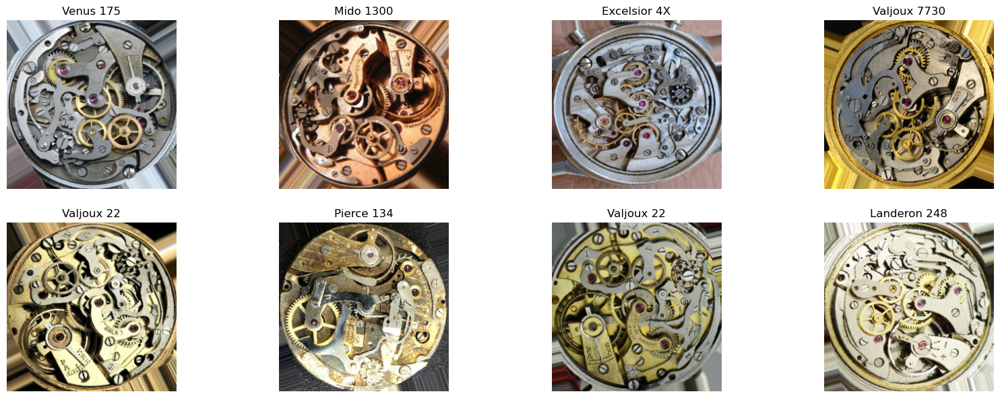

In [9]:
plt.figure(figsize=(20, 15))
image_batch, image_labels = train_gen.next()
for i in range(BATCH_SIZE):
    image = image_batch[i]
    label = image_labels[i]
    ax = plt.subplot(int(BATCH_SIZE/2), int(BATCH_SIZE/2), i + 1)
    plt.imshow(image)
    plt.title(class_dict[label]) #int(np.argwhere(label==1))
    plt.axis("off")

## 3. Train a model

The [Sequential](https://www.tensorflow.org/guide/keras/sequential_model) model consists of three convolution blocks (`tf.keras.layers.Conv2D`) with a max pooling layer (`tf.keras.layers.MaxPooling2D`) in each of them. There's fully-connected layers (`tf.keras.layers.Dense`) with 4096 units on top of it that is activated by a ReLU activation function (`'relu'`). This model will be tuned.

Let's choose the `tf.keras.optimizers.Adam` optimizer and `tf.keras.losses.SparseCategoricalCrossentropy` loss function. To view training and validation accuracy for each training epoch, pass the `metrics` argument to `Model.compile`.

In [10]:
def create_uncompiled_model(name='VGG16', dropout=0.5, n_block_unfreeze=1):
    if name == 'VGG19':
        vgg19_model = VGG19(include_top=False, 
                            input_shape=(256,256,3))
        sub_model = Model(vgg19_model.input, 
                          vgg19_model.output)
        sub_model.trainable = True
        for layer in sub_model.layers[:-5*n_block_unfreeze]:
            layer.trainable=False

        x = Flatten()(sub_model.output)
        x = Dense(4096, activation='relu')(x)
        x = Dropout(dropout)(x)
        x = Dense(4096, activation='relu')(x)
        x = Dropout(dropout)(x)
        outputs = Dense(NUM_CLASSES, activation="softmax")(x)
        model = Model(inputs=sub_model.input, 
                      outputs=outputs)
    
    elif name=='VGG16' :              
        vgg16_model = VGG16(include_top=False, 
                            input_shape=(256,256,3))
        sub_model = Model(vgg16_model.input, 
                          vgg16_model.output)
        sub_model.trainable = True
        for layer in sub_model.layers[:-4*n_block_unfreeze]:
            layer.trainable=False

        x = Flatten()(sub_model.output)
        x = Dense(4096, activation='relu')(x)
        x = Dropout(dropout)(x)
        x = Dense(4096, activation='relu')(x)
        x = Dropout(dropout)(x)
        outputs = Dense(NUM_CLASSES, activation="softmax")(x)
        model = Model(inputs=sub_model.input, 
                      outputs=outputs)
    
    elif name=='ResNet50V2':
        conv_base = ResNet50V2(include_top=False)

        conv_base.trainable = False

        inputs = Input(shape=(256, 256, 3))
        x = conv_base(inputs)
        x = Conv2D(128, (3, 3), activation='relu')(x)
        x = MaxPooling2D(pool_size=(2, 2))(x)
        x = Flatten()(x)
        x = Dense(100, activation='relu')(x)
        outputs = Dense(NUM_CLASSES, activation='softmax')(x)
        model = Model(inputs, outputs)   
        
    elif name=='ResNet152':             
        resnet152_model = ResNet152(include_top=False, 
                            input_shape=(256,256,3))
        sub_model = Model(resnet152_model.input, 
                          resnet152_model.output)
        
        sub_model.trainable = False

        x = Flatten()(sub_model.output)
        x = Dense(4096, activation='relu')(x)
        x = Dropout(dropout)(x)
        x = Dense(4096, activation='relu')(x)
        x = Dropout(dropout)(x)
        outputs = Dense(NUM_CLASSES, activation="softmax")(x)
        model = Model(inputs=sub_model.input, 
                      outputs=outputs)
        
    else : 
        print('Entrez un nom de modèle valide')

    return model

In [14]:
def adjust_learning_rate(name='VGG16'):
    
    model = create_uncompiled_model(name)
    
    early_stop = EarlyStopping(monitor='loss', patience=5)
    lr_schedule = LearningRateScheduler(lambda epoch: 1e-2 * 10**(epoch / 20))
    
    # Select your optimizer
    optimizer = Adadelta()
    
    # Compile the model passing in the appropriate loss
    model.compile(loss=losses.SparseCategoricalCrossentropy, #tensorflow.keras.losses.Huber(),
                  optimizer=optimizer, 
                  metrics=["accuracy"]) 
    
    history = model.fit(train_gen, epochs=20, callbacks=[lr_schedule, early_stop])
    
    return history

In [ ]:
with tf.device("/cpu:0"):
    lr_history = adjust_learning_rate()

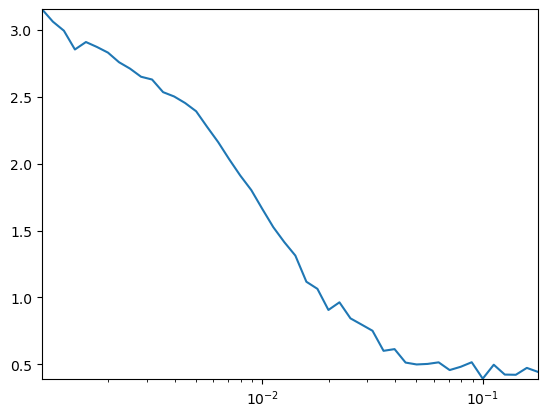

In [75]:
# Plot the loss for every LR
plt.semilogx(lr_history.history["lr"], 
             lr_history.history["loss"])
plt.axis([np.min(lr_history.history["lr"]), 
          np.max(lr_history.history["lr"]), 
          np.min(lr_history.history["loss"]), 
          np.max(lr_history.history["loss"])]);

In [11]:
with tf.device("/cpu:0"):
    model = create_uncompiled_model('VGG16', dropout=0.5)

In [16]:
#model.summary()

In [12]:
logdir = "logs/image/" + datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = TensorBoard(log_dir = logdir, histogram_freq = 1)
file_writer_cm = tf.summary.create_file_writer(logdir + '/cm')

In [13]:
def plot_confusion_matrix(cm, class_names):
    """
    Returns a matplotlib figure containing the plotted confusion matrix.
    
    Args:
       cm (array, shape = [n, n]): a confusion matrix of integer classes
       class_names (array, shape = [n]): String names of the integer classes
    """
    
    figure = plt.figure(figsize=(8, 8))
    plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
    plt.title("Confusion matrix")
    plt.colorbar()
    tick_marks = np.arange(len(class_names))
    plt.xticks(tick_marks, class_names, rotation=45)
    plt.yticks(tick_marks, class_names)
    
    # Normalize the confusion matrix.
    cm = np.around(cm.astype('float') / cm.sum(axis=1)[:, np.newaxis], decimals=2)
    
    # Use white text if squares are dark; otherwise black.
    threshold = cm.max() / 2.
    
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        color = "white" if cm[i, j] > threshold else "black"
        plt.text(j, i, cm[i, j], horizontalalignment="center", color=color)
        
    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    return figure

In [14]:
def plot_to_image(figure):
    """
    Converts the matplotlib plot specified by 'figure' to a PNG image and
    returns it. The supplied figure is closed and inaccessible after this call.
    """
    
    buf = io.BytesIO()
    
    # Use plt.savefig to save the plot to a PNG in memory.
    plt.savefig(buf, format='png')
    
    # Closing the figure prevents it from being displayed directly inside
    # the notebook.
    plt.close(figure)
    buf.seek(0)
    
    # Use tf.image.decode_png to convert the PNG buffer
    # to a TF image. Make sure you use 4 channels.
    image = tf.image.decode_png(buf.getvalue(), channels=4)
    
    # Use tf.expand_dims to add the batch dimension
    image = tf.expand_dims(image, 0)
    
    return image

In [15]:
def log_confusion_matrix(epoch, logs):
    
    # Use the model to predict the values from the test_images.
    test_pred_raw = model.predict(valid_gen)
    
    test_pred = np.argmax(test_pred_raw, axis=1)
    
    # Calculate the confusion matrix using sklearn.metrics
    cm = sklearn.metrics.confusion_matrix(valid_gen.classes, test_pred)
    
    figure = plot_confusion_matrix(cm, class_names=CLASS_NAMES)
    cm_image = plot_to_image(figure)
    
    # Log the confusion matrix as an image summary.
    with file_writer_cm.as_default():
        tf.summary.image("Confusion Matrix", cm_image, step=epoch)

In [16]:
cm_callback = LambdaCallback(on_epoch_end=log_confusion_matrix)

In [17]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', 
                              factor=0.3,
                              patience=2)

In [18]:
model_chk = ModelCheckpoint(filepath='best_model_VGG16.keras', 
                            save_best_only=True, 
                            monitor='val_loss')

In [20]:
model.compile(optimizer=Adadelta(learning_rate=10e-2), #Adadelta(learning_rate=6e-2) for VGG / Adam(learning_rate=5e-5)
              loss=losses.sparse_categorical_crossentropy, 
              metrics=['accuracy'])

In [23]:
#with tf.device("/cpu:0"):
history = model.fit(train_gen,
                    epochs=5,
                    validation_data=valid_gen,
                    callbacks=[reduce_lr, model_chk, tensorboard_callback, cm_callback])

Epoch 1/5
73/73 [==============================] - 216s 3s/step - loss: 0.0601 - accuracy: 0.9880 - val_loss: 0.5200 - val_accuracy: 0.8370 - lr: 2.4300e-04
Epoch 2/5
73/73 [==============================] - 230s 3s/step - loss: 0.0749 - accuracy: 0.9759 - val_loss: 0.5188 - val_accuracy: 0.8370 - lr: 2.4300e-04
Epoch 3/5
73/73 [==============================] - 210s 3s/step - loss: 0.0736 - accuracy: 0.9742 - val_loss: 0.5148 - val_accuracy: 0.8370 - lr: 2.4300e-04
Epoch 4/5
73/73 [==============================] - 230s 3s/step - loss: 0.0710 - accuracy: 0.9793 - val_loss: 0.5159 - val_accuracy: 0.8370 - lr: 2.4300e-04
Epoch 5/5
73/73 [==============================] - 221s 3s/step - loss: 0.0686 - accuracy: 0.9776 - val_loss: 0.5185 - val_accuracy: 0.8370 - lr: 2.4300e-04


In [ ]:
accuracy = history.history["accuracy"]
val_accuracy = history.history["val_accuracy"]
loss = history.history["loss"]
val_loss = history.history["val_loss"]
epochs = range(1, len(accuracy) + 1)
plt.plot(epochs, accuracy, "bo", label="Training accuracy")
plt.plot(epochs, val_accuracy, "b", label="Validation accuracy")
plt.title("Training and validation accuracy")
plt.legend()
plt.figure()
plt.plot(epochs, loss, "bo", label="Training loss")
plt.plot(epochs, val_loss, "b", label="Validation loss")
plt.title("Training and validation loss")
plt.legend()
plt.show()

In [ ]:
%load_ext tensorboard
%tensorboard --logdir logs/image

In [27]:
model.save('/models/model_vgg16_22022023')

INFO:tensorflow:Assets written to: /models/model_vgg16_22022023\assets


INFO:tensorflow:Assets written to: /models/model_vgg16_22022023\assets


You may notice the validation accuracy is low compared to the training accuracy, indicating the model is overfitting. [tutorial](https://www.tensorflow.org/tutorials/keras/overfit_and_underfit).

## Part 2 - Results interpretation

In [ ]:
with tf.device("/cpu:0"):
    model = tf.keras.models.load_model("best_model_VGG16.keras")

In [28]:
layer_outputs=[]
layer_names=[]

for layer in model.layers:
    if isinstance(layer, (Conv2D, MaxPooling2D)):
        layer_outputs.append(layer.output)
        layer_names.append(layer.name)
activation_model = Model(inputs=model.input, outputs=layer_outputs)

In [29]:
def get_img_array(img_path, target_size):
    img = load_img(img_path, target_size=target_size)
    array = img_to_array(img)
    array = np.expand_dims(array, axis=0)
    return array

In [55]:
img_path = 'test_image_4.jpg'
test_img = get_img_array(img_path, (256, 256, 3))

In [56]:
with tf.device("/cpu:0"):
    preds = model.predict(test_img)
    print("Predicted:", class_dict[np.argmax(preds[0])])

1/1 [==============================] - 0s 141ms/step
Predicted: Valjoux 92


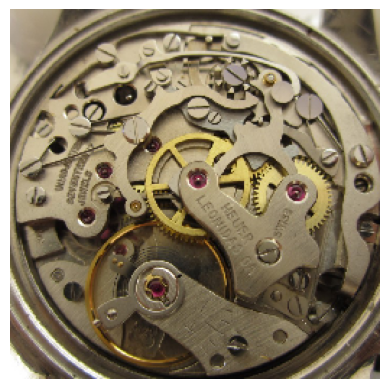

In [57]:
plt.axis('off')
plt.imshow(test_img[0].astype('uint8'))
plt.show()

1/1 [==============================] - 0s 75ms/step


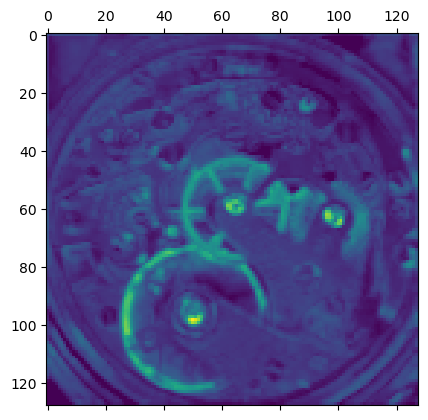

In [58]:
activations = activation_model.predict(test_img)
plt.matshow(activations[2][0,:,:,2], cmap='viridis')
plt.show()

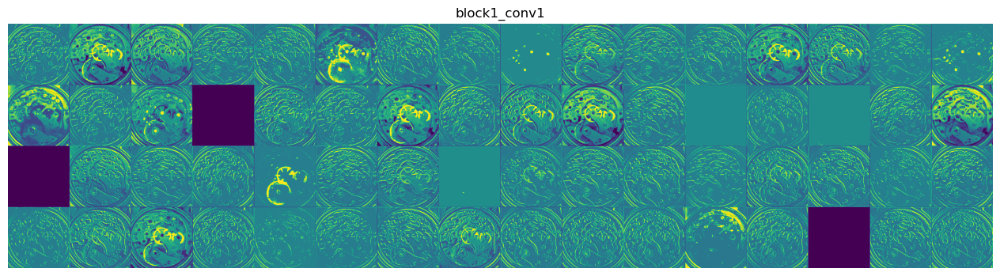

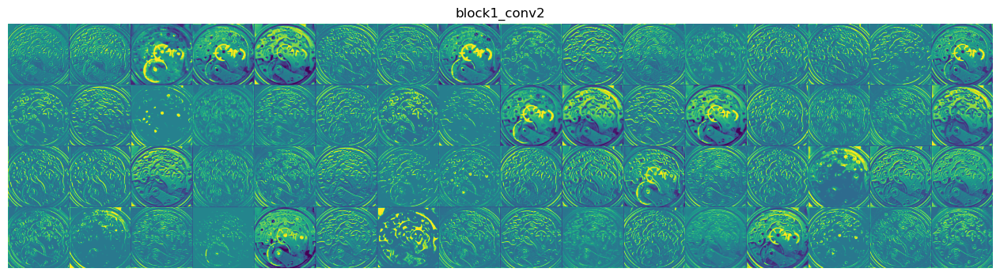

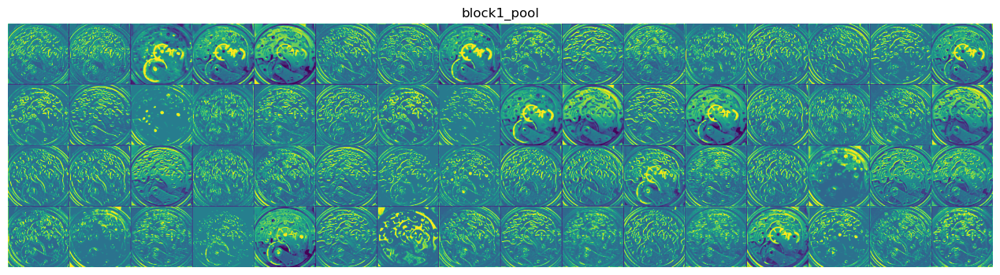

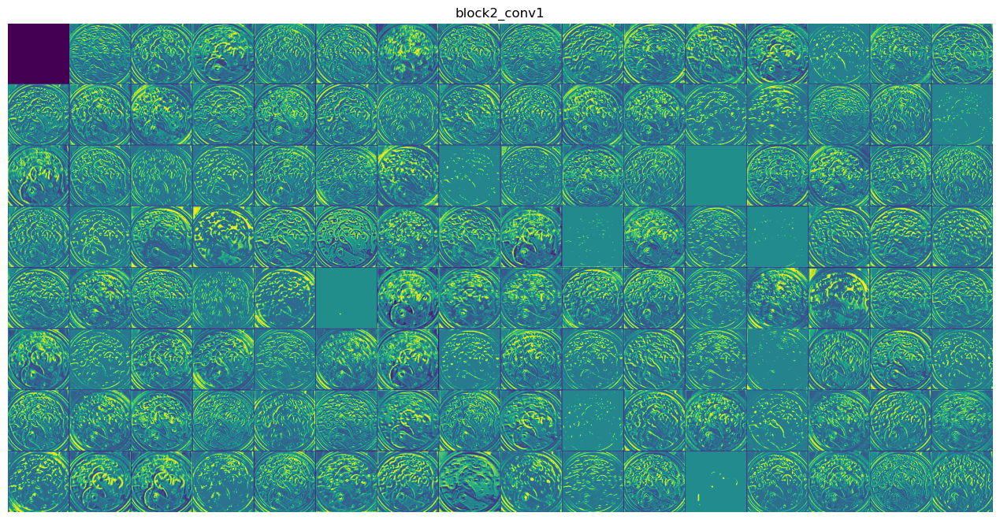

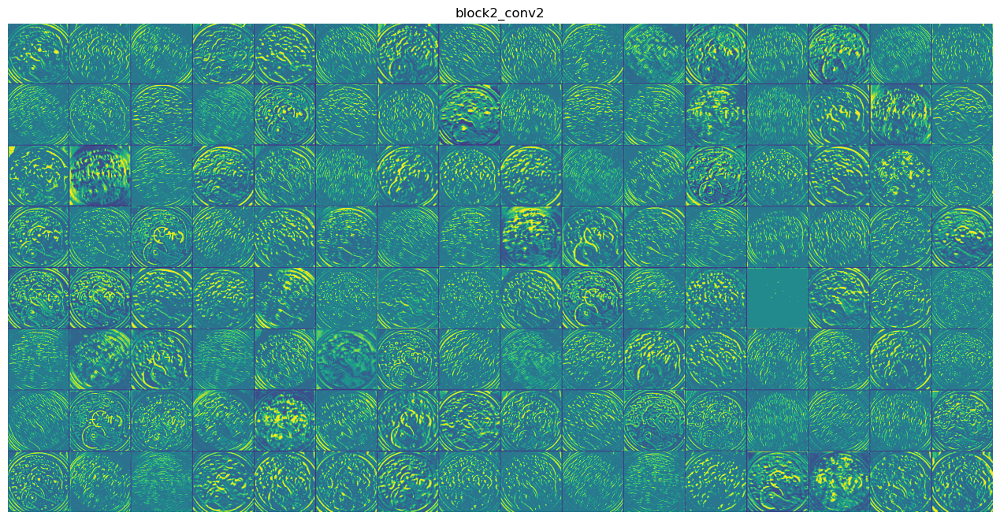

...

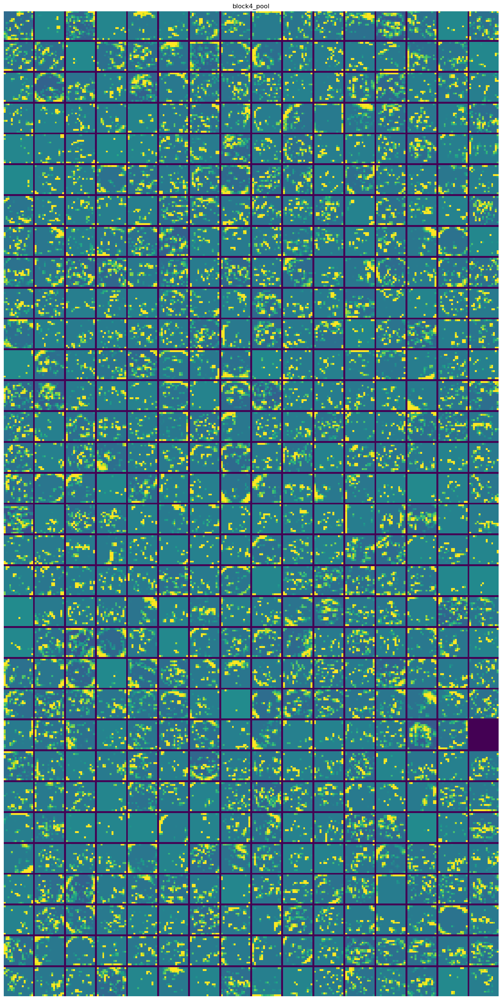

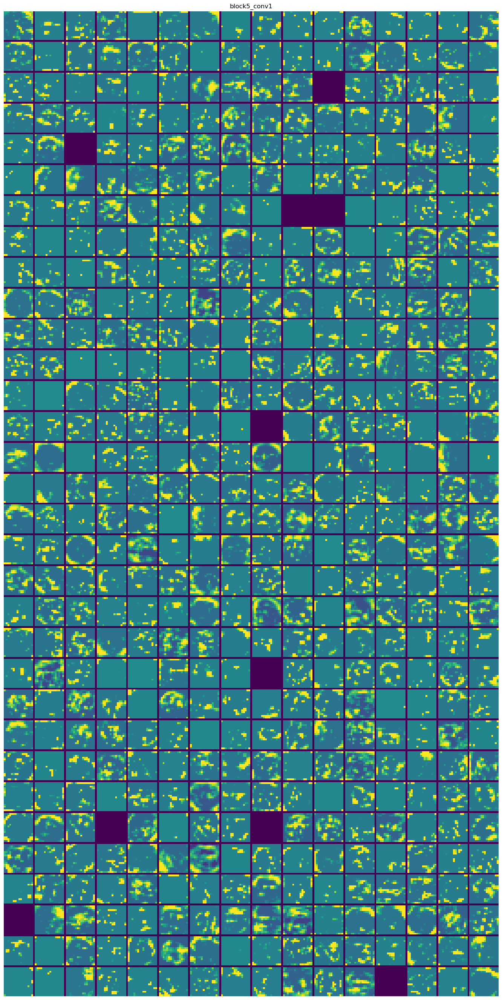

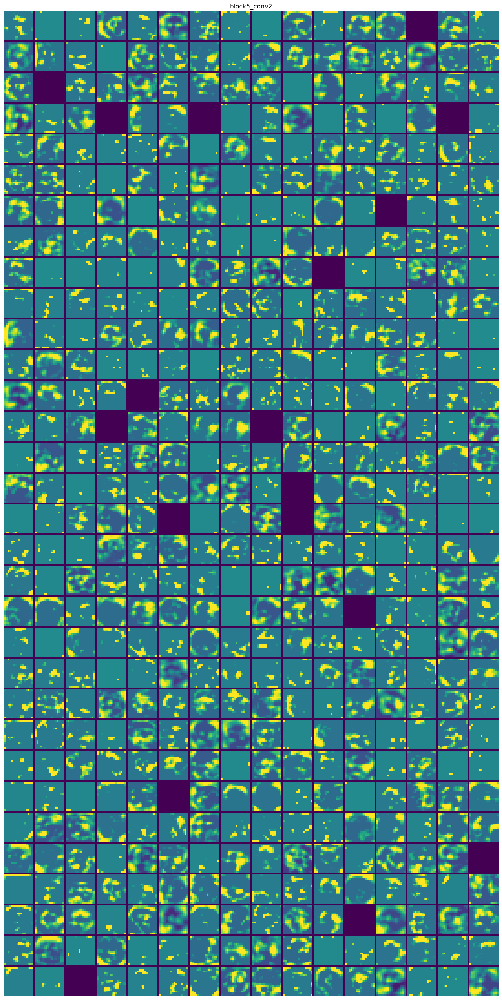

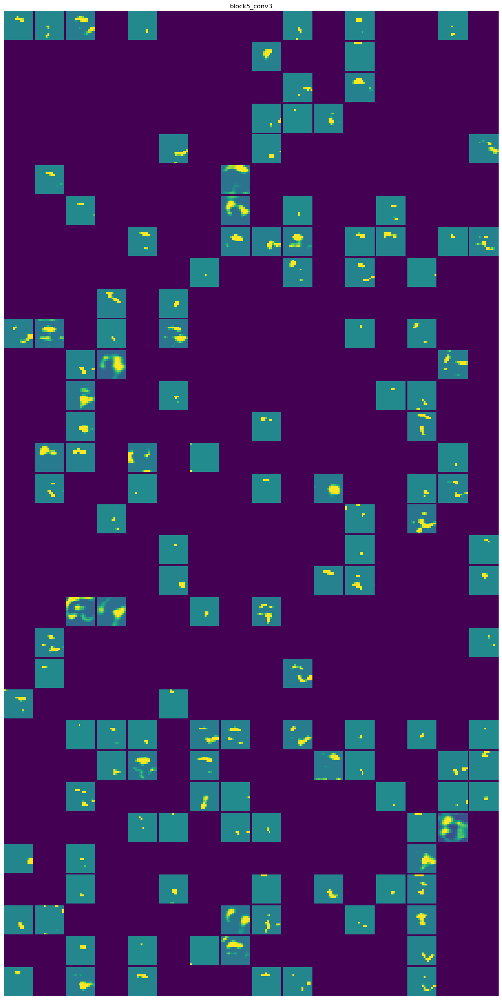

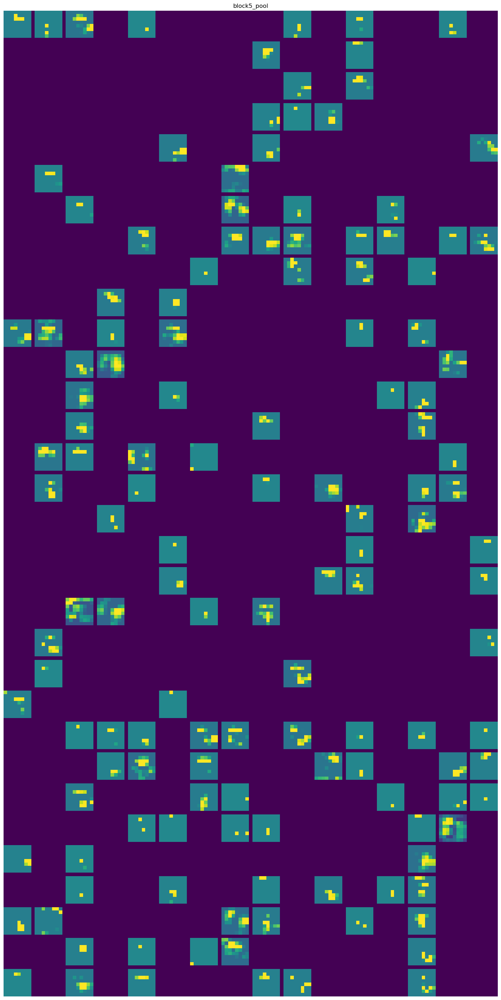

In [59]:
images_per_row = 16
for layer_name, layer_activation in zip(layer_names, activations):
    n_features = layer_activation.shape[-1]
    size = layer_activation.shape[1]
    n_cols = n_features // images_per_row
    display_grid = np.zeros(((size + 1) * n_cols - 1,
                             images_per_row * (size + 1) - 1))
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_index = col * images_per_row + row
            channel_image = layer_activation[0, :, :, channel_index].copy()
            if channel_image.sum() != 0:
                channel_image -= channel_image.mean()
                channel_image /= channel_image.std()
                channel_image *= 64
                channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype("uint8")
            display_grid[
                col * (size + 1): (col + 1) * size + col,
                row * (size + 1) : (row + 1) * size + row] = channel_image
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],
                        scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.axis("off")
    plt.imshow(display_grid, aspect="auto", cmap="viridis")

In [68]:
#model.summary()

In [61]:
last_conv_layer_name = "block5_conv3"

In [62]:
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    # First, we create a model that maps the input image to the activations
    # of the last conv layer as well as the output predictions
    grad_model = tf.keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )

    # Then, we compute the gradient of the top predicted class for our input image
    # with respect to the activations of the last conv layer
    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    # This is the gradient of the output neuron (top predicted or chosen)
    # with regard to the output feature map of the last conv layer
    grads = tape.gradient(class_channel, last_conv_layer_output)

    # This is a vector where each entry is the mean intensity of the gradient
    # over a specific feature map channel
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    # We multiply each channel in the feature map array
    # by "how important this channel is" with regard to the top predicted class
    # then sum all the channels to obtain the heatmap class activation
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    # For visualization purpose, we will also normalize the heatmap between 0 & 1
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

In [65]:
model.layers[-1].activation = None

In [66]:
def save_and_display_gradcam(img_path, heatmap, cam_path="cam.jpg", alpha=0.4):
    # Load the original image
    img = tf.keras.preprocessing.image.load_img(img_path)
    img = tf.keras.preprocessing.image.img_to_array(img)

    # Rescale heatmap to a range 0-255
    heatmap = np.uint8(255 * heatmap)

    # Use jet colormap to colorize heatmap
    jet = cm.get_cmap("jet")

    # Use RGB values of the colormap
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    # Create an image with RGB colorized heatmap
    jet_heatmap = tf.keras.preprocessing.image.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = tf.keras.preprocessing.image.img_to_array(jet_heatmap)

    # Superimpose the heatmap on original image
    superimposed_img = jet_heatmap * alpha + img
    superimposed_img = tf.keras.preprocessing.image.array_to_img(superimposed_img)

    # Save the superimposed image
    superimposed_img.save(cam_path)

    # Display Grad CAM
    #display(Image(cam_path))
    plt.matshow(superimposed_img)
    plt.axis('off')
    plt.colorbar()
    plt.show()

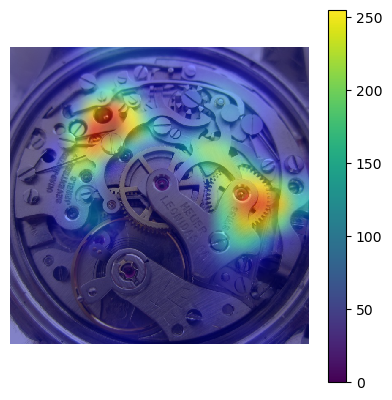

In [67]:
heatmap = make_gradcam_heatmap(test_img, model, last_conv_layer_name)
save_and_display_gradcam(img_path, heatmap, alpha=0.95)